# Visualize the quality of different LDA model over time

- multiple datasets
- different parameter choices 
- several evaluation metrics

In [1]:
import gc
from os.path import join
from constants import LDA_PATH, LSI_PATH, PARAMS, NBTOPICS, VERSIONS, DATASETS
import pandas as pd
from gensim.models import LdaModel, LsiModel
from utils import load
import json
%pylab inline
import seaborn as sns
from itertools import islice, chain

pd.options.display.max_columns = 30
pd.options.display.width = 800
pd.options.display.precision = 3

Populating the interactive namespace from numpy and matplotlib


/home/andreas/bin/anaconda3/lib/python3.6/site-packages/IPython/core/magics/pylab.py:160: UserWarning: pylab import has clobbered these variables: ['load']
`%matplotlib` prevents importing * from pylab and numpy
  "\n`%matplotlib` prevents importing * from pylab and numpy"


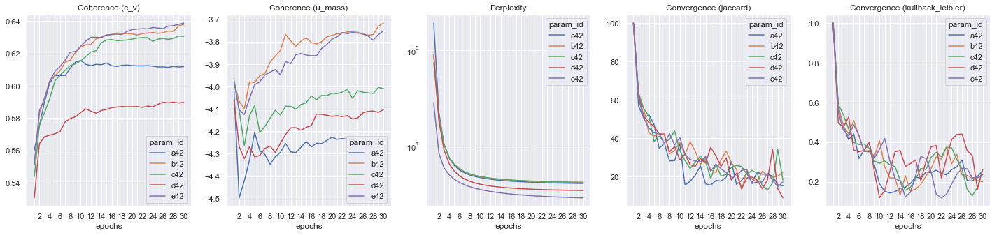

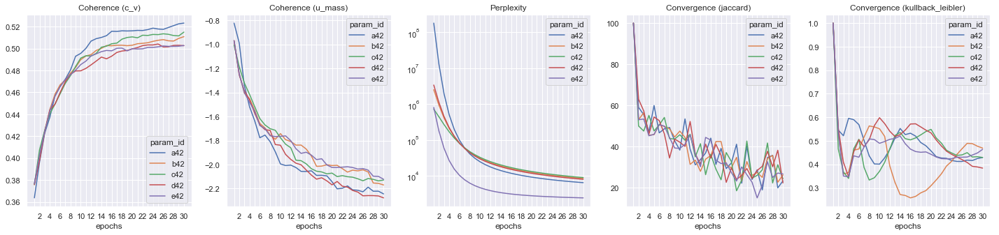

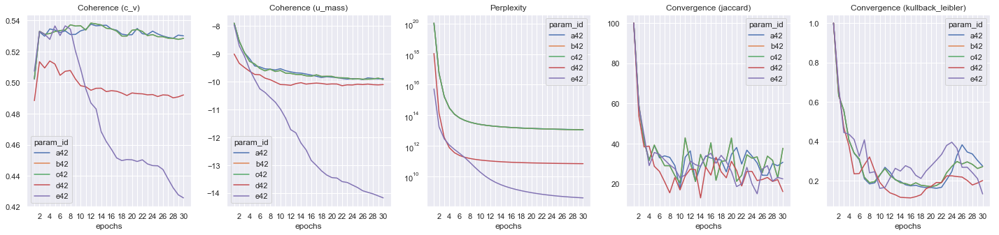

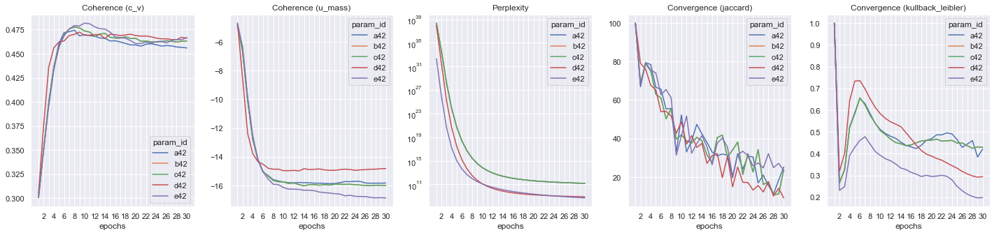

In [84]:
pert = 'Perplexity (test)'
cohu = 'Coherence (u_mass)'
cohc = 'Coherence (c_v)'
convkl = 'Diff (kullback_leibler)'
conv = 'Convergence (jaccard)'
metrics = [pert, cohu, cohc, convkl, conv]

empty_metrics = {
    'Perplexity (test)': [None],
    'Coherence (u_mass)': [None],
    'Coherence (c_v)': [None],
    'Diff (kullback_leibler)': [None],
    'Convergence (jaccard)': [None],
}

def load_metrics(dataset, nbfiles=None, version='noun', corpus='bow', epochs=30):
    param_ids = [f'{c}42_split' for c in list('abcde')]
    nb_topics_list = [100]
    metrics = []
    for param_id in param_ids:
        for nb_topics in nb_topics_list:
            file = join(LDA_PATH, version, corpus, param_id, f'{dataset}_LDAmodel_{param_id}_{nb_topics}_ep{epochs}_metrics.json')
            try:
                with open(file, 'r') as fp:
                    data = json.load(fp)
            except FileNotFoundError as e:
                print(e)
                data = {k: v*epochs for k, v in empty_metrics.items()}
            df = pd.DataFrame.from_dict(data)
            df = df.assign(
                dataset=dataset,
                param_id=param_id,
                nb_topics=nb_topics,
            )
            df.index += 1
            df.index.name = 'epochs'
            df = df.set_index(['dataset', 'param_id', 'nb_topics'], append=True).reorder_levels([1, 2, 3, 0])
            df['Diff (kullback_leibler)'] = df['Diff (kullback_leibler)'].apply(mean)
            df.columns = empty_metrics.keys()
            metrics.append(df)
    return pd.concat(metrics)

def subframes(df, n):
    d = df.query(f'nb_topics == {n}')
    d.index = d.index.droplevel(['dataset', 'nb_topics'])
    d_cohc = d[cohc].unstack('epochs').T
    d_cohu = d[cohu].unstack('epochs').T
    d_pert = d[pert].unstack('epochs').T
    d_conv = d[conv].unstack('epochs').T
    d_convkl = d[convkl].unstack('epochs').T
    return d_cohc, d_cohu, d_pert, d_conv, d_convkl

def prepare_data(dataset, nbfiles=None, version='noun', corpus='bow', epochs=30):
    df = load_metrics(dataset, nbfiles, version, corpus, epochs)
    subf = [subframes(df, 100)]
    return df, subf

def plot_subframes(dataset, data, version='', corpus='', print_subframe=False, save=True):
    metrics = [cohc, cohu, pert, conv, convkl]
    sns.set()
    pylab.rcParams['figure.figsize'] = (20, 5)
    xticks=range(1, 31)

    fig, axs = plt.subplots(nrows=len(data), ncols=len(metrics))
    for i, subframes in enumerate(data):
        for j, kv in enumerate(zip(metrics, subframes)):
            metric, subframe = kv
            kwargs = dict()
            if i == 0:
                kwargs['title'] = metric
            if metric.startswith('Per'):
                kwargs['title'] = 'Perplexity'
                kwargs['logy'] = True
            elif metric.startswith('Diff'):
                kwargs['title'] = 'Convergence (kullback_leibler)'
            subframe = subframe.rename(columns=lambda x: x.strip('_split'))
            if print_subframe:
                print(dataset, version, corpus)
                print(subframe)
            subframe.plot(ax=axs[j], xticks=xticks, sharex=True, **kwargs)
            for label in axs[j].xaxis.get_ticklabels()[::2]:
                label.set_visible(False)
    #fig.suptitle(f'{dataset} -- {version} -- {corpus}', size=18, weight='heavy', x=.01, y=.99, ha='left', va='top')
    plt.tight_layout(rect=[0, 0, 1, 0.97])
    if save:
        fig.savefig(f'../img/{dataset.lower()}_{corpus}_epochs.pdf', bbox_inches='tight')

    
def run_epochs(datasets=None, version='noun', corpus='bow', epochs=30, save=True):
    if datasets is None:
        datasets = ['dewac', 'news', DATASETS['O'], DATASETS['P']]
            #+ ['dewac', 'dewiki']
            #+ [DATASETS['E'], DATASETS['FA'], DATASETS['FO'], DATASETS['P']]

    subfs = dict()
    for dataset in islice(datasets, None):
        df, subf = prepare_data(dataset, version=version, corpus=corpus, epochs=30)
        subfs[dataset] = subf
        plot_subframes(dataset, subf, version, corpus, print_subframe=False)
    
datasets = ['news', 'PoliticalSpeeches']
run_epochs(datasets=datasets, version='noun', corpus='bow', epochs=30)
run_epochs(datasets=datasets, version='noun', corpus='tfidf', epochs=30)

# tf-idf b und c fast identisch, a auch sehr nah

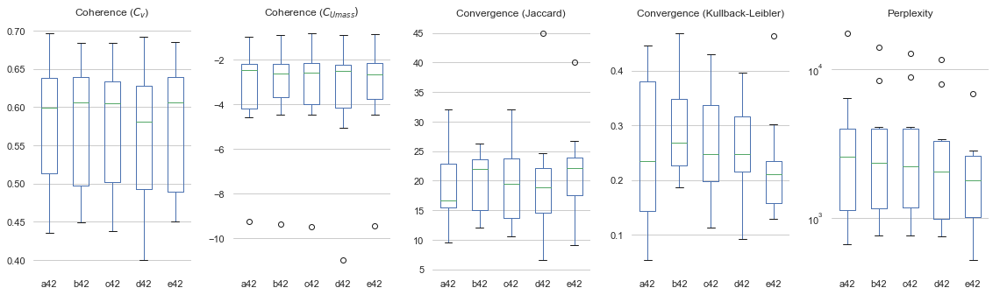

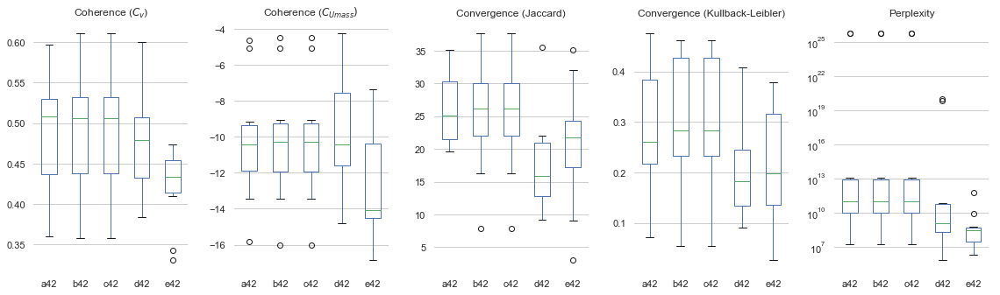

In [86]:
titles = {
    'Perplexity (test)': 'Perplexity',
    'Coherence (u_mass)': 'Coherence ($C_{Umass})$',
    'Coherence (c_v)': 'Coherence ($C_v$)',
    'Diff (kullback_leibler)': 'Convergence (Kullback-Leibler)',
    'Convergence (jaccard)': 'Convergence (Jaccard)',
}

def run_avg(datasets=None, version='noun', corpus='bow', epochs=30):
    sns.set(style="whitegrid")
    subfs = dict()
    for dataset in islice(datasets, None):
        df, subf = prepare_data(dataset, version=version, corpus=corpus, epochs=30)
        subfs[dataset] = subf
        
    # 1st key gives metrics for a dataset
    # 2nd key return the different topic sizes [10, 25, 50, 100] --> [-1]: training with 100 topics
    # 3rd key returns the evaluation metric [perplexity, coherence u_mass, coherence c_v, convergence] --> [2]: C_v evaluation metric
    # 4th key returns the last training epoch where our topics come from
    sizes = [100]
    metrics = [cohc, cohu, pert, conv, convkl]
    sets = []
    results = []
    for dataset in datasets:
        ress = []
        for i, s in enumerate(metrics):
            res = subfs[dataset][-1][i].iloc[-1, :].to_frame()
            res['num_topics'] = s
            ress.append(res)
        res = pd.concat(ress).set_index('num_topics', append=True)
        sets.append(dataset)
        results.append(res)

    df = pd.concat(results, axis=1)
    df.columns = sets
    pylab.rcParams['figure.figsize'] = (16, 5)
    fig, axs = plt.subplots(nrows=1, ncols=len(metrics), sharey=False)
    sns.despine(bottom=True, left=True)
    df = df.groupby('num_topics')
    for i, key_group in enumerate(df):
        key, group = key_group
        group.index = group.index.droplevel('num_topics')
        group = group.T.rename(columns=lambda x: x.strip('_split'))
        group.plot(kind='box', ax=axs[i], title=titles[key])
    #fig.suptitle('All corpora (100 topics)', size=18, weight='heavy', x=.01, y=.99, ha='left', va='top')
    for ax in axs:
        ax.xaxis.label.set_visible(False)
        ax.xaxis.grid(False)
    axs[4].set_yscale("log", nonposy='clip')
    plt.tight_layout(rect=[0, 0, 1, 0.97])
    fig.savefig(f'../img/{corpus}_traindistribution.pdf', bbox_inches='tight')

datasets = ['dewiki', 'dewac', 'dewac1', 'news', 'speeches', DATASETS['O'], DATASETS['E'], DATASETS['FA'], DATASETS['FO'], DATASETS['P']]
run_avg(datasets=datasets, version='noun', corpus='bow', epochs=30)
run_avg(datasets=datasets, version='noun', corpus='tfidf', epochs=30)

----

### compare to LSI

In [80]:
from constants import DATASETS
from utils import load
ldas = []
lsis = []
for dset in DATASETS.values():
    lda_scores = load(dset, 'scores')[['c_v_wikt', 'c_npmi_wikt', 'mean_similarity_ftx']]
    lda_scores = lda_scores.query('nb_topics == 100 and param_id == "e42"')
    ldas.append(lda_scores)
    lsi_scores = load(dset, 'lsi', 'scores')[['c_v_wikt', 'c_npmi_wikt', 'mean_similarity_ftx']]
    lsi_scores = lsi_scores.query('nb_topics == 100')
    lsis.append(lsi_scores)

ren = {
    'c_v_wikt': '$C_v$',
    'c_npmi_wikt': '$C_{NPMI}$',
    'mean_similarity_ftx': '$MeanSim_{ftx}$',
}    

ldas = pd.concat(ldas).reset_index(['param_id', 'nb_topics'], drop=True).rename(columns=ren)
lsis = pd.concat(lsis).reset_index(['param_id', 'nb_topics'], drop=True).rename(columns=ren)

Reading ../data/preprocessed/LDAmodel/noun/bow/topics/dewac_noun_bow_topic-scores.csv
Reading ../data/preprocessed/LDAmodel/noun/bow/topics/dewac_noun_bow_topic-scores_germanet.csv
Reading ../data/preprocessed/LDAmodel/noun/bow/topics/dewac_lsi_noun_bow_topic-scores.csv
Reading ../data/preprocessed/LDAmodel/noun/bow/topics/dewac_lsi_noun_bow_topic-scores_germanet.csv
Reading ../data/preprocessed/LDAmodel/noun/bow/topics/dewac1_noun_bow_topic-scores.csv
Reading ../data/preprocessed/LDAmodel/noun/bow/topics/dewac1_noun_bow_topic-scores_germanet.csv
Reading ../data/preprocessed/LDAmodel/noun/bow/topics/dewac1_lsi_noun_bow_topic-scores.csv
Reading ../data/preprocessed/LDAmodel/noun/bow/topics/dewac1_lsi_noun_bow_topic-scores_germanet.csv
Reading ../data/preprocessed/LDAmodel/noun/bow/topics/dewiki_noun_bow_topic-scores.csv
Reading ../data/preprocessed/LDAmodel/noun/bow/topics/dewiki_noun_bow_topic-scores_germanet.csv
Reading ../data/preprocessed/LDAmodel/noun/bow/topics/dewiki_lsi_noun_bow

In [81]:
ldas

$C_v$  $C_{NPMI}$  $MeanSim_{ftx}$
dataset  topic_idx                                    
dewac    0          0.485       0.046            0.581
         1          0.525       0.050            0.602
         2          0.395      -0.076            0.551
         3          0.715       0.166            0.658
         4          0.856       0.202            0.742
         5          0.511       0.070            0.695
         6          0.719       0.166            0.692
         7          0.587       0.082            0.625
         8          0.571       0.081            0.655
         9          0.689       0.160            0.681
         10         0.586       0.086            0.604
         11         0.730       0.146            0.716
         12         0.481      -0.004            0.621
         13         0.768       0.151            0.671
         14         0.463       0.054            0.619
         15         0.616       0.122            0.614
         16         0.719       0.152            0.699
         17         0.586       0.098            0.640
         18         0.763       0.194            0.733
         19         0.791       0.252            0.693
         20         0.519       0.052            0.630
         21         0.518       0.071            0.595
         22         0.586       0.106            0.632
         23         0.708       0.149            0.708
         24         0.588       0.088            0.647
         25         0.705       0.192            0.730
         26         0.814       0.221            0.747
         27         0.621       0.100            0.686
         28         0.582       0.090            0.702
         29         0.703       0.143            0.685
...                   ...         ...              ...
speeches 70         0.571       0.086            0.663
         71         0.669       0.142            0.644
         72         0.374      -0.021            0.572
         73         0.417       0.022            0.590
         74         0.605       0.104            0.638
         75         0.478       0.012            0.602
         76         0.463       0.038            0.608
         77         0.676       0.121            0.642
         78         0.484       0.057            0.616
         79         0.508       0.028            0.599
         80         0.541       0.088            0.609
         81         0.566       0.083            0.635
         82         0.764       0.215            0.736
         83         0.427       0.027            0.611
         84         0.454       0.039            0.587
         85         0.538       0.071            0.627
         86         0.495       0.043            0.615
         87         0.713       0.176            0.694
         88         0.580       0.056            0.633
         89         0.575       0.086            0.592
         90         0.660       0.159            0.660
         91         0.549       0.081            0.633
         92         0.525       0.078            0.641
         93         0.416       0.009            0.597
         94         0.522       0.064            0.573
         95         0.339      -0.041            0.528
         96         0.546       0.079            0.607
         97         0.723       0.154            0.722
         98         0.544       0.073            0.635
         99         0.358       0.004            0.600

[1000 rows x 3 columns]

In [82]:
comp = pd.concat([ldas.mean(), lsis.mean()], axis=1)
comp['difference'] = lda_scores.mean() - lsis.mean()
comp

,0,1,difference
$C_v$,0.551,0.386,NaN
$C_{NPMI}$,0.078,-0.008,NaN
$MeanSim_{ftx}$,0.628,0.562,NaN


Text(0.5,0.98,'')

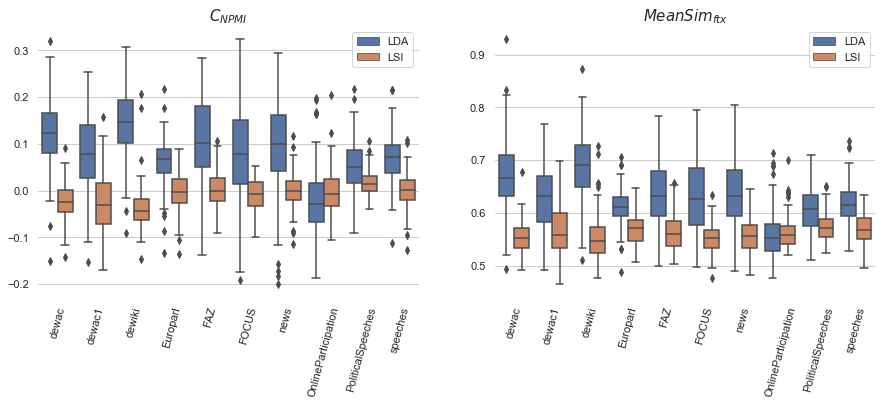

In [107]:
ldas['vars'] = 'LDA'
lsis['vars'] = 'LSI'
df = pd.concat([ldas, lsis], axis=0).reset_index('dataset').reset_index(drop=True)

sns.set(style="whitegrid")

# Initialize the figure
scale = 15

fig, axs = plt.subplots(ncols=2, figsize=(scale, scale*0.33))
sns.despine(bottom=True, left=True)
rotation = 75

sns.boxplot(x='dataset', y="$C_{NPMI}$", hue="vars", data=df, ax=axs[0])
sns.boxplot(x='dataset', y="$MeanSim_{ftx}$", hue="vars", data=df, ax=axs[1])
for ax in axs:
    ax.xaxis.label.set_visible(False)
    ax.xaxis.grid(False)
    ax.set_xticklabels(rotation=rotation, labels=ax.get_xticklabels())
    ax.legend(loc=0).set_title('')
    ax.set_ylabel("")
label_size = scale
axs[0].set_title("$C_{NPMI}$", weight='bold', size=label_size)
axs[1].set_title("$MeanSim_{ftx}$", weight='bold', size=label_size)

fig.savefig(f'../img/lda_vs_lsi.pdf', bbox_inches='tight')

plt.suptitle('')

In [2]:
pert = 'Perplexity (test)'
cohu = 'Coherence (u_mass)'
cohc = 'Coherence (c_v)'
conv = 'Convergence (jaccard)'
metrics = [pert, cohu, cohc, conv]

empty_metrics = {
    'Perplexity (test)': [None],
    'Coherence (u_mass)': [None],
    'Coherence (c_v)': [None],
    'Diff (kullback_leibler)': [None],
    'Convergence (jaccard)': [None],
}

def load_metrics(dataset, nbfiles=None, version='noun', corpus='bow', epochs=30):
    param_ids = [f'{c}42_split' for c in list('abcde')]
    nb_topics_list = [10, 25, 50, 100]
    metrics = []
    for param_id in param_ids:
        for nb_topics in nb_topics_list:
            file = join(LDA_PATH, version, corpus, param_id, f'{dataset}_LDAmodel_{param_id}_{nb_topics}_ep{epochs}_metrics.json')
            try:
                with open(file, 'r') as fp:
                    data = json.load(fp)
            except FileNotFoundError as e:
                print(e)
                data = {k: v*epochs for k, v in empty_metrics.items()}
            df = pd.DataFrame.from_dict(data)
            df = df.assign(
                dataset=dataset,
                param_id=param_id,
                nb_topics=nb_topics,
            )
            df.index += 1
            df.index.name = 'epochs'
            df = df.set_index(['dataset', 'param_id', 'nb_topics'], append=True).reorder_levels([1, 2, 3, 0])
            df.columns = empty_metrics.keys()
            metrics.append(df)
    return pd.concat(metrics)

def subframes(df, n):
    d = df.query(f'nb_topics == {n}')
    d.index = d.index.droplevel(['dataset', 'nb_topics'])
    d_pert = d[pert].unstack('epochs').T
    d_cohu = d[cohu].unstack('epochs').T
    d_cohc = d[cohc].unstack('epochs').T
    d_conv = d[conv].unstack('epochs').T
    return d_pert, d_cohu, d_cohc, d_conv

def prepare_data(dataset, nbfiles=None, version='noun', corpus='bow', epochs=30):
    df = load_metrics(dataset, nbfiles, version, corpus, epochs)
    subf = [subframes(df, 10), subframes(df, 25), subframes(df, 50), subframes(df, 100)]
    return df, subf

def plot_subframes(dataset, data, version='', corpus='', print_subframe=False):
    sns.set()
    pylab.rcParams['figure.figsize'] = (30, 20)
    xticks=range(1, 31)

    fig, axs = plt.subplots(nrows=len(data), ncols=len(metrics))
    for i, subframes in enumerate(data):
        for j, kv in enumerate(zip(metrics, subframes)):
            metric, subframe = kv
            kwargs = dict()
            if i == 0:
                kwargs['title'] = metric
            if metric.startswith('Per'):
                #kwargs['title'] = 'Perplexity'
                kwargs['logy'] = True
            subframe = subframe.rename(columns=lambda x: x.strip('_split'))
            if print_subframe:
                print(dataset, version, corpus)
                print(subframe)
            subframe.plot(ax=axs[i][j], xticks=xticks, sharex=True, **kwargs)
            for label in axs[i][j].xaxis.get_ticklabels()[::2]:
                label.set_visible(False)
    fig.suptitle(f'{dataset} -- {version} -- {corpus}', size=18, weight='heavy', x=.01, y=.99, ha='left', va='top')
    plt.tight_layout(rect=[0, 0, 1, 0.97])
    
def run(datasets=None, version='noun', corpus='bow', epochs=30):
    if datasets is None:
        datasets = ['dewac1', 'news', DATASETS['O'], 'speeches']
            #+ ['dewac', 'dewiki']
            #+ [DATASETS['E'], DATASETS['FA'], DATASETS['FO'], DATASETS['P']]

    subfs = dict()
    for dataset in islice(datasets, None):
        df, subf = prepare_data(dataset, version=version, corpus=corpus, epochs=30)
        subfs[dataset] = subf
        plot_subframes(dataset, subf, version, corpus, print_subframe=False)
        
    # 1st key gives metrics for a dataset
    # 2nd key return the different topic sizes [10, 25, 50, 100] --> [-1]: training with 100 topics
    # 3rd key returns the evaluation metric [perplexity, coherence u_mass, coherence c_v, convergence] --> [2]: C_v evaluation metric
    # 4th key returns the last training epoch where our topics come from
    sizes = [10, 25, 50, 100]
    sets = []
    results = []
    for dataset in datasets:
        ress = []
        for i, s in enumerate(sizes):
            res = subfs[dataset][i][2].iloc[-1, :].to_frame()
            res['num_topics'] = s
            ress.append(res)
        res = pd.concat(ress).set_index('num_topics', append=True)
        sets.append(dataset)
        results.append(res)

    df = pd.concat(results, axis=1)
    df.columns = sets
    pylab.rcParams['figure.figsize'] = (20, 7.5)
    fig, axs = plt.subplots(nrows=1, ncols=4, sharey=True)
    df = df.groupby('num_topics')
    for i, key_group in enumerate(df):
        key, group = key_group
        group.index = group.index.droplevel('num_topics')
        group = group.T.rename(columns=lambda x: x.strip('_split'))
        group.plot(kind='box', ax=axs[i], title=f'{key} topics')
    fig.suptitle('Coherence ($C_v$)', size=18, weight='heavy', x=.01, y=.99, ha='left', va='top')
    plt.tight_layout(rect=[0, 0, 1, 0.97])

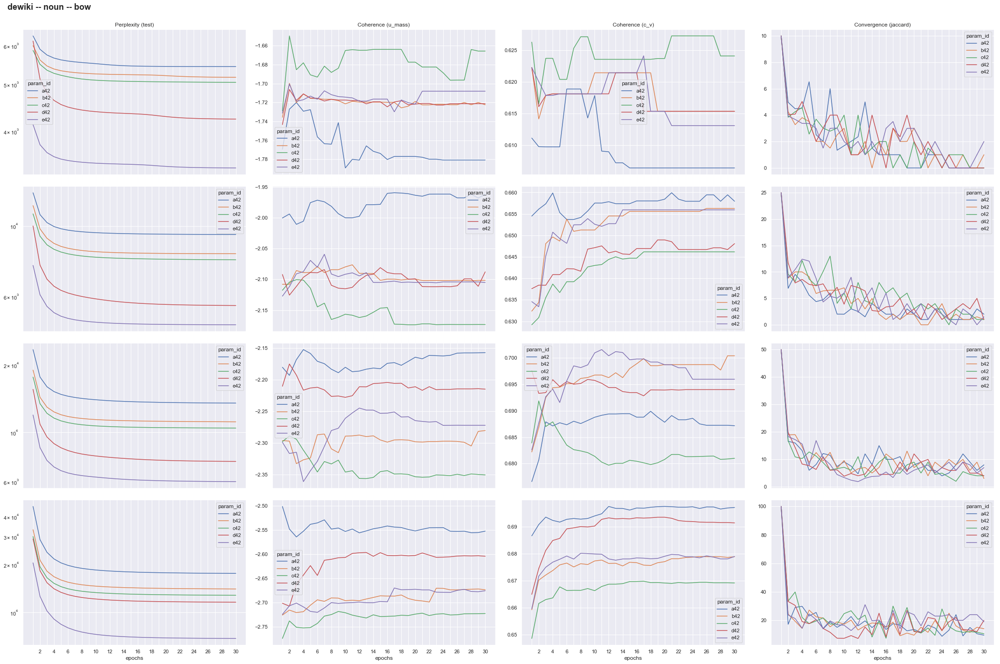

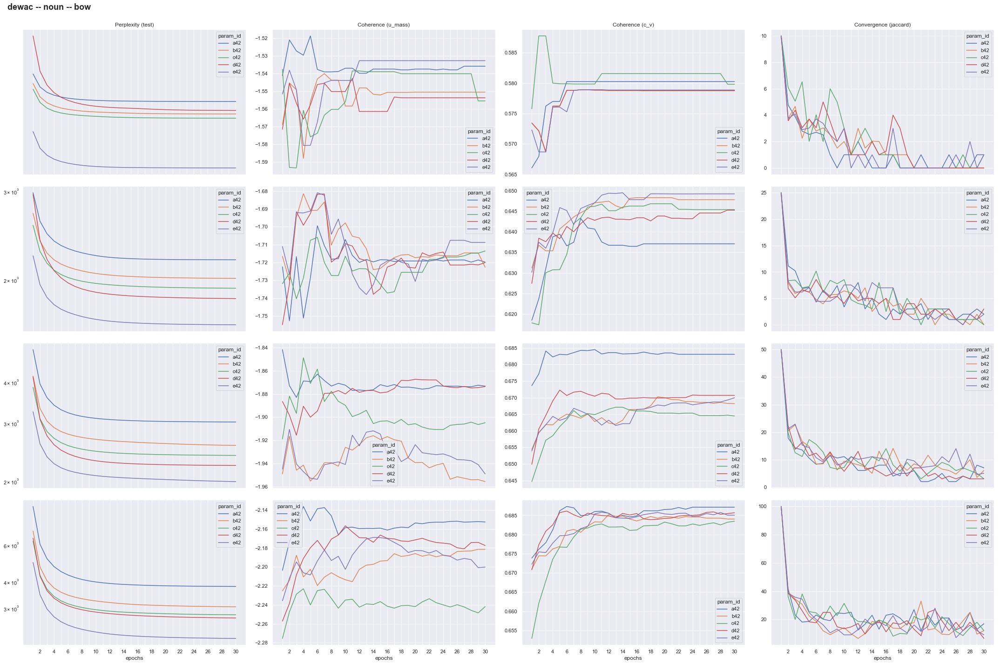

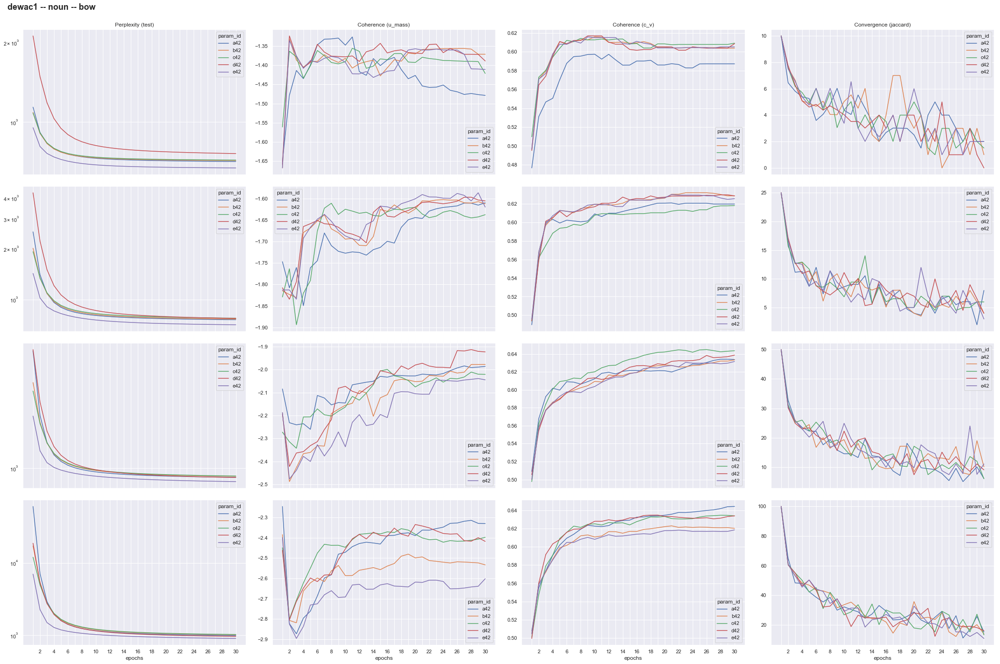

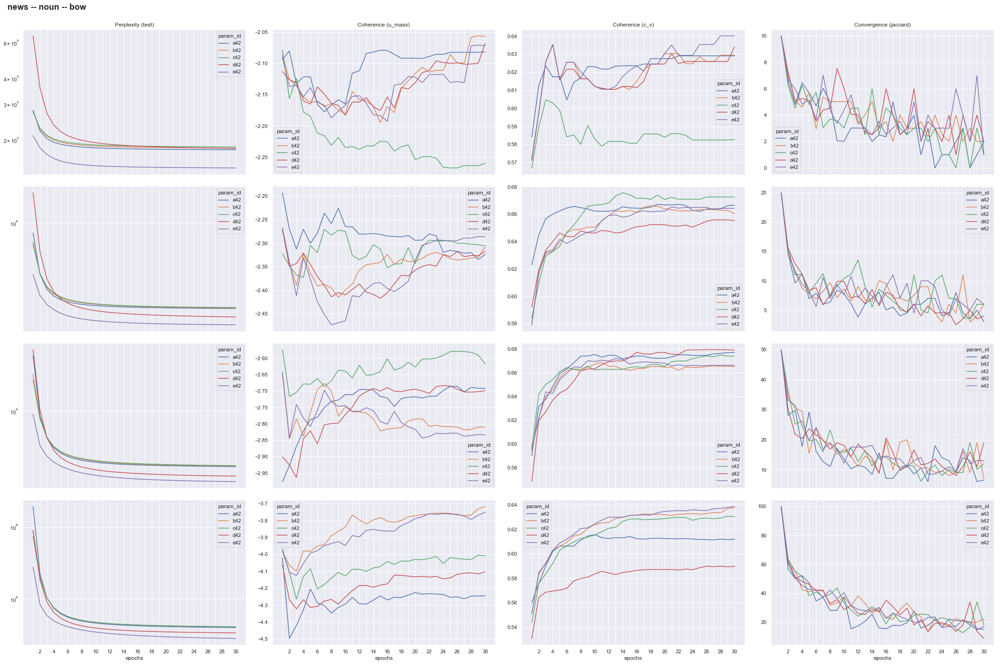

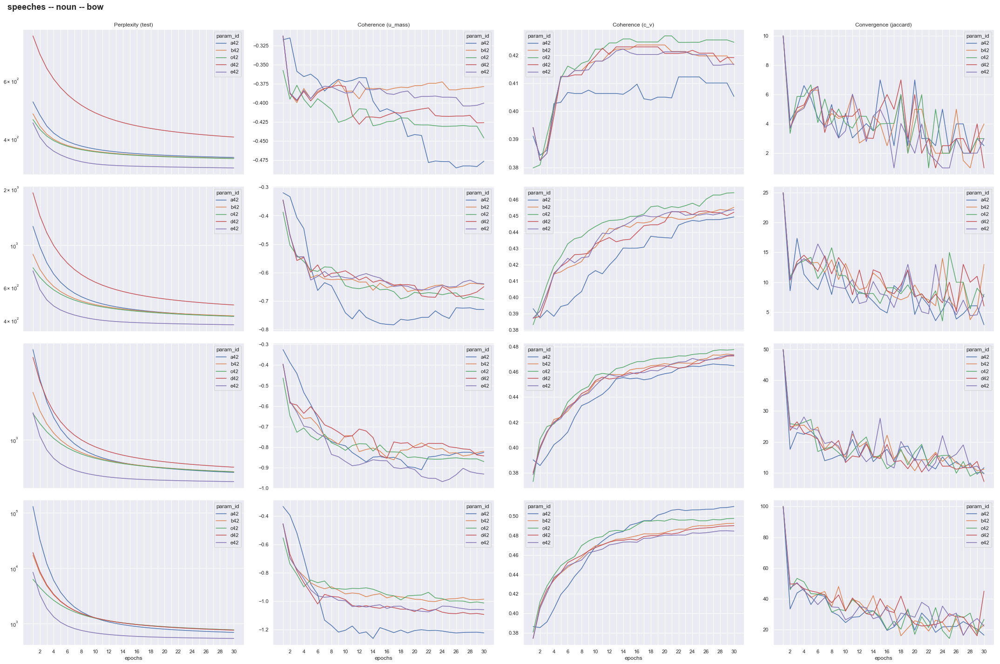

...

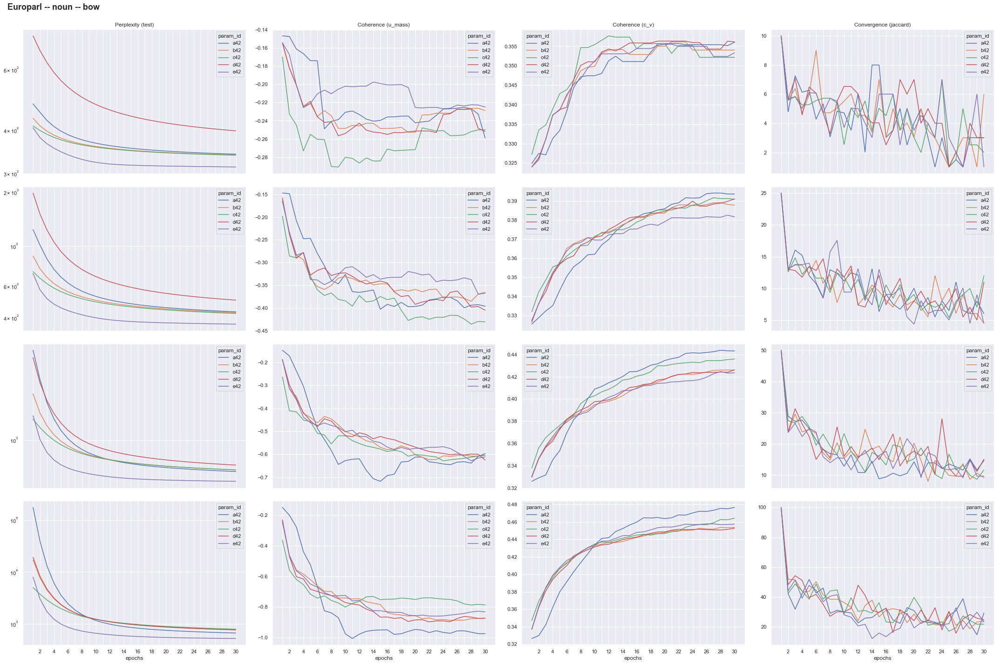

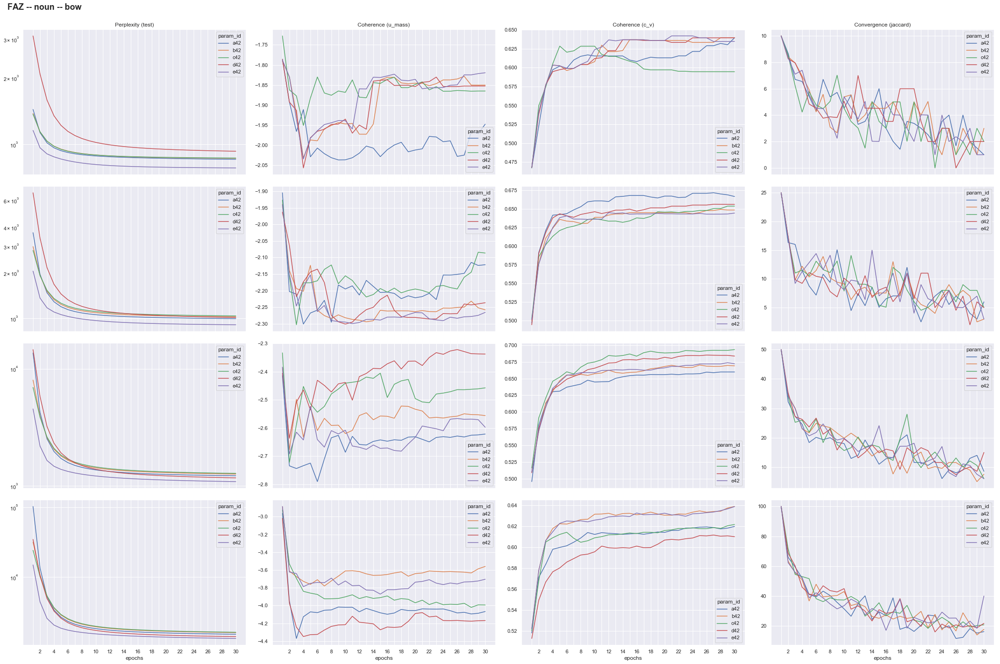

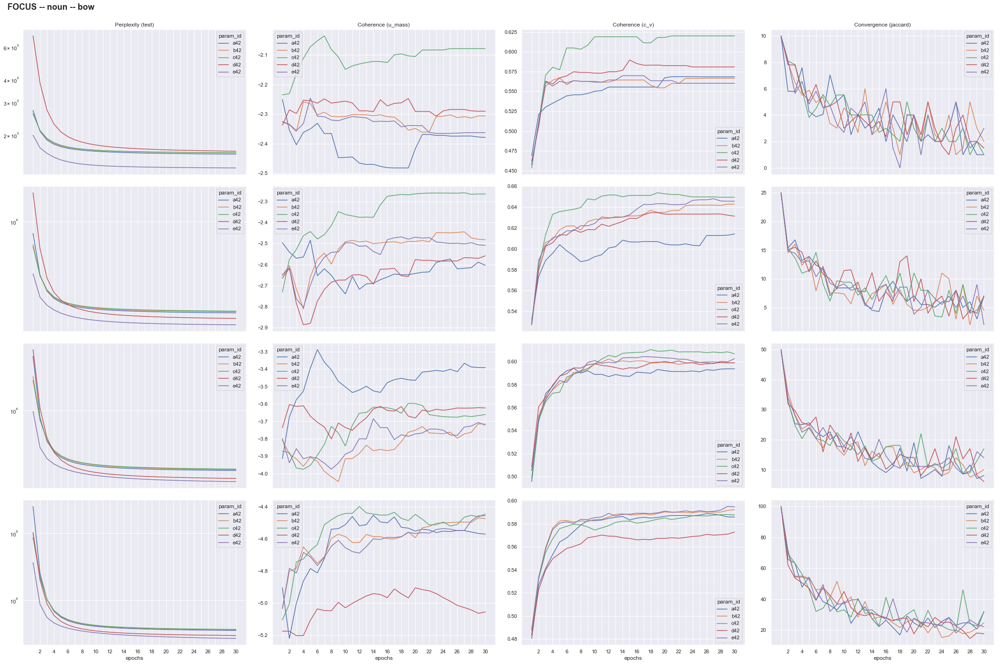

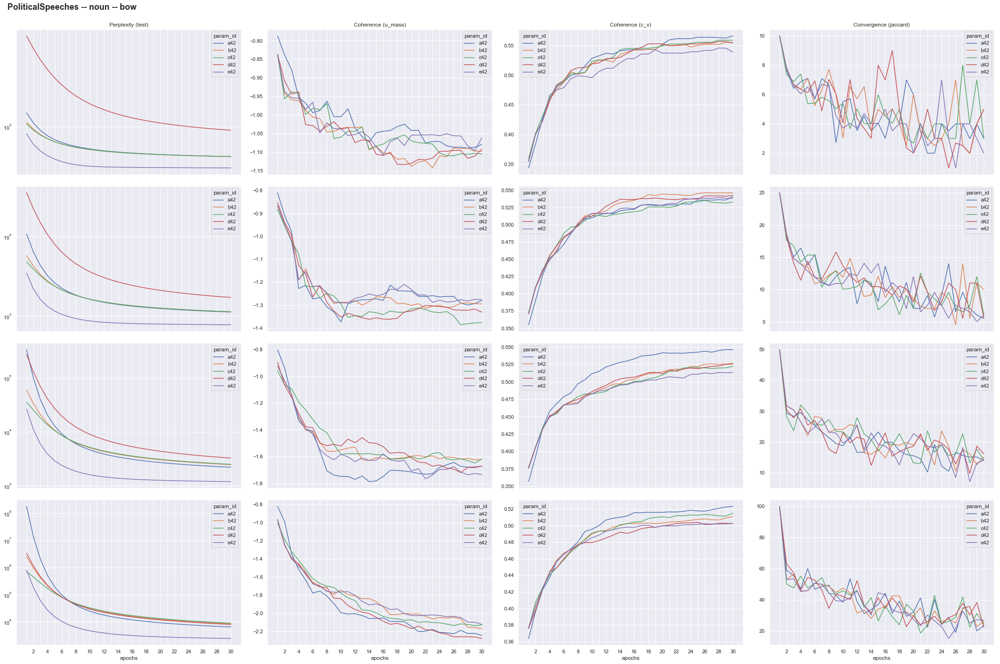

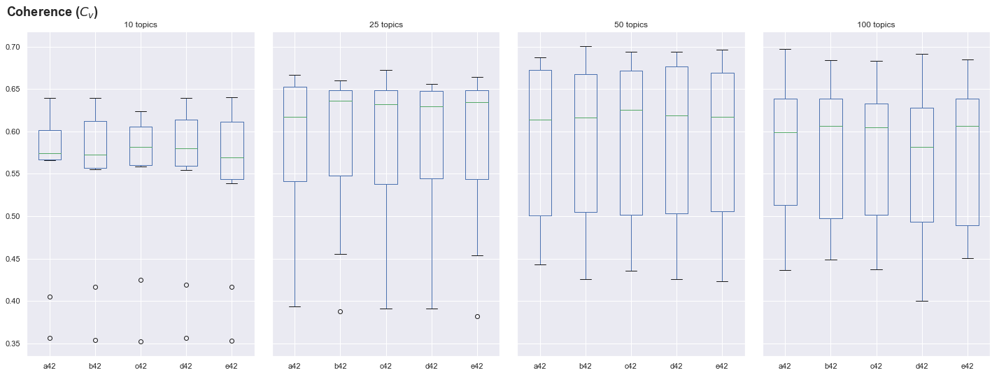

In [3]:
datasets = ['dewiki', 'dewac', 'dewac1', 'news', 'speeches', DATASETS['O'], DATASETS['E'], DATASETS['FA'], DATASETS['FO'], DATASETS['P']]
run(datasets=datasets, version='noun', corpus='bow', epochs=30)

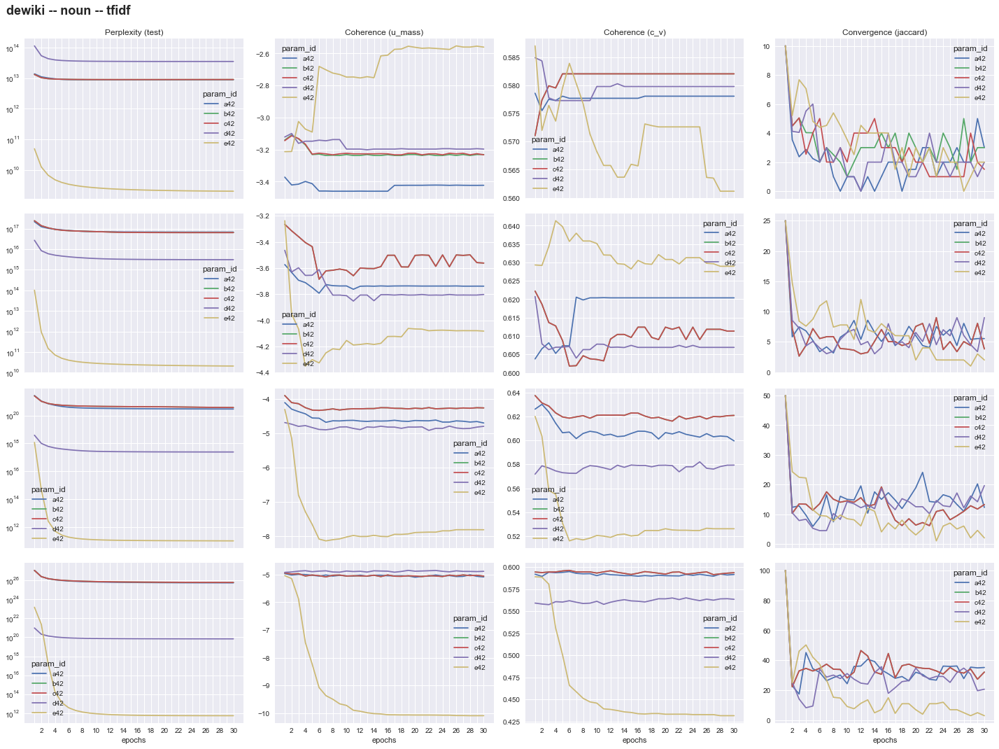

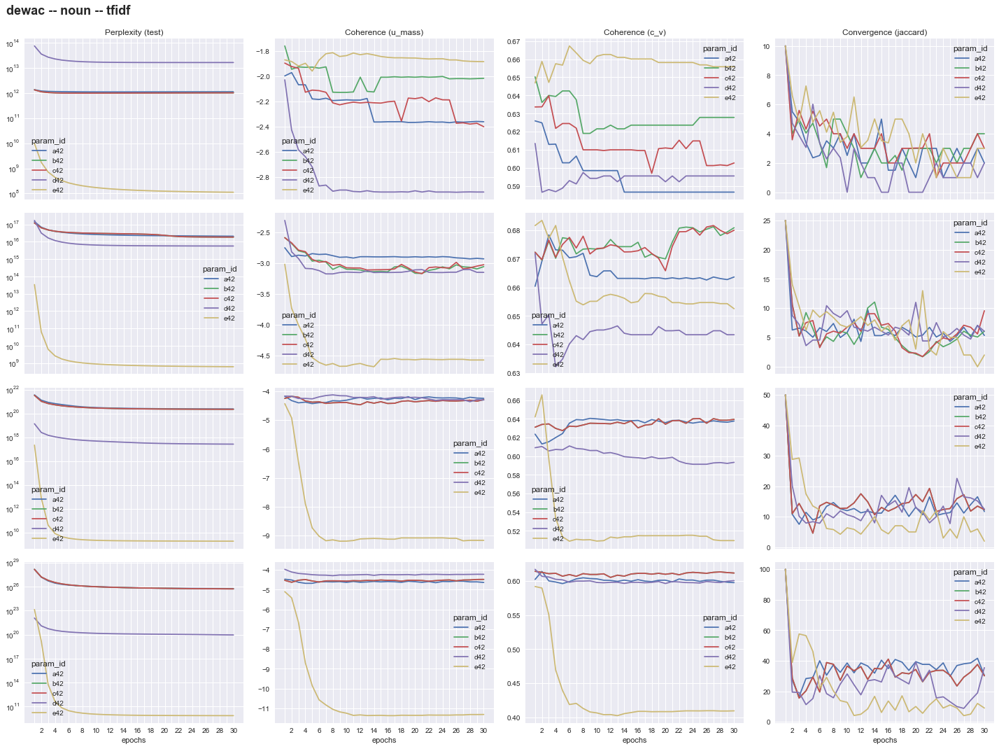

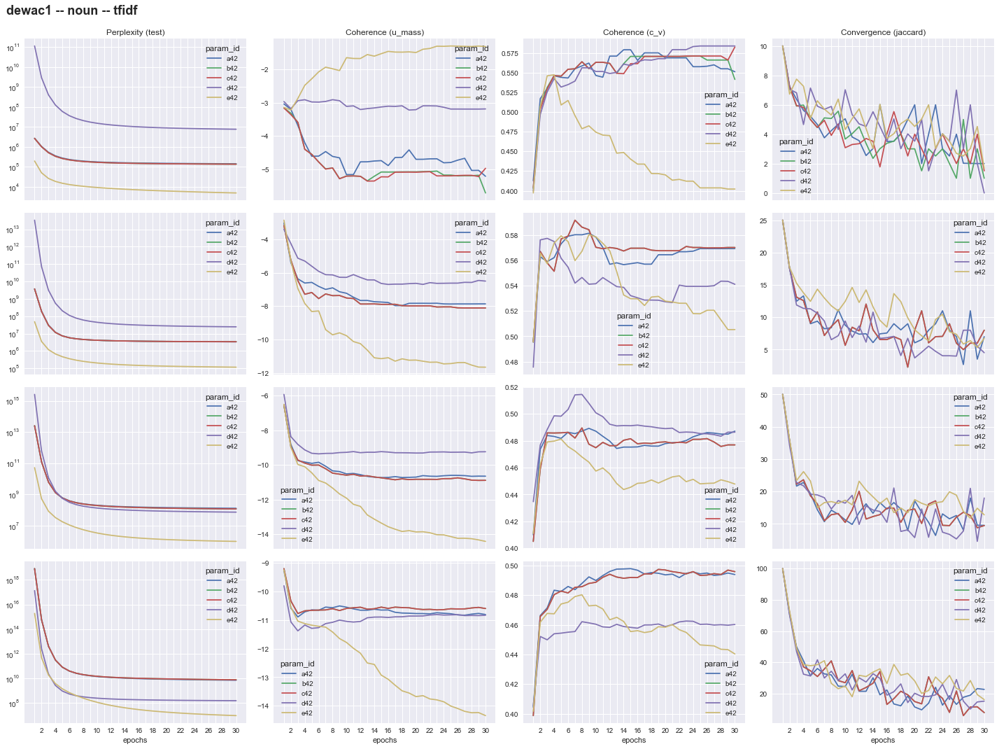

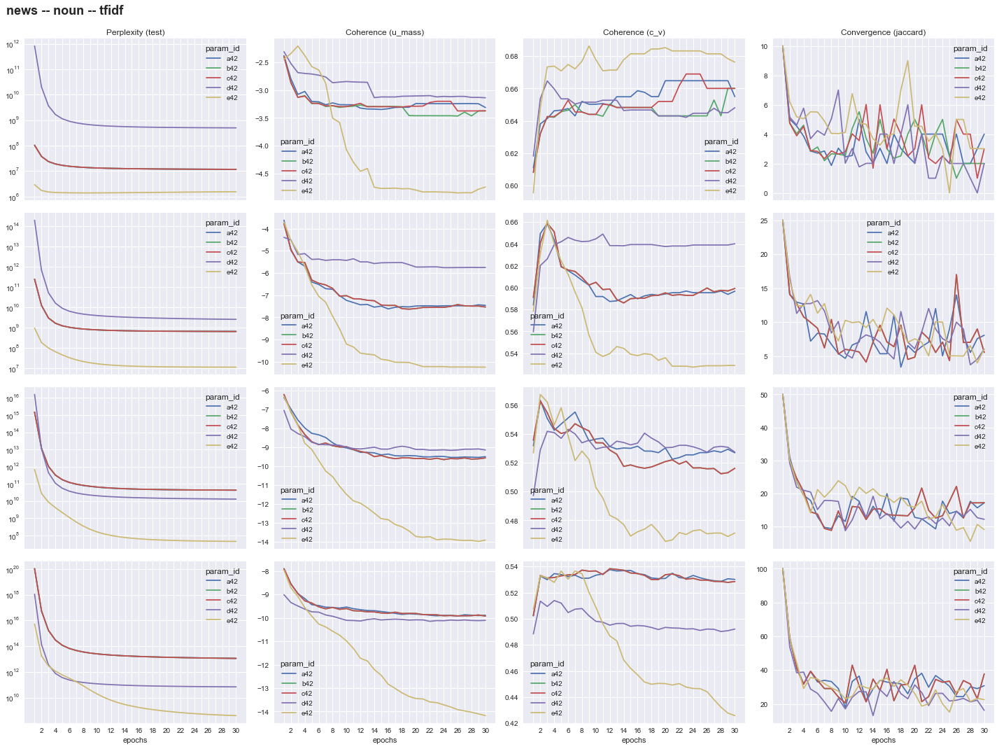

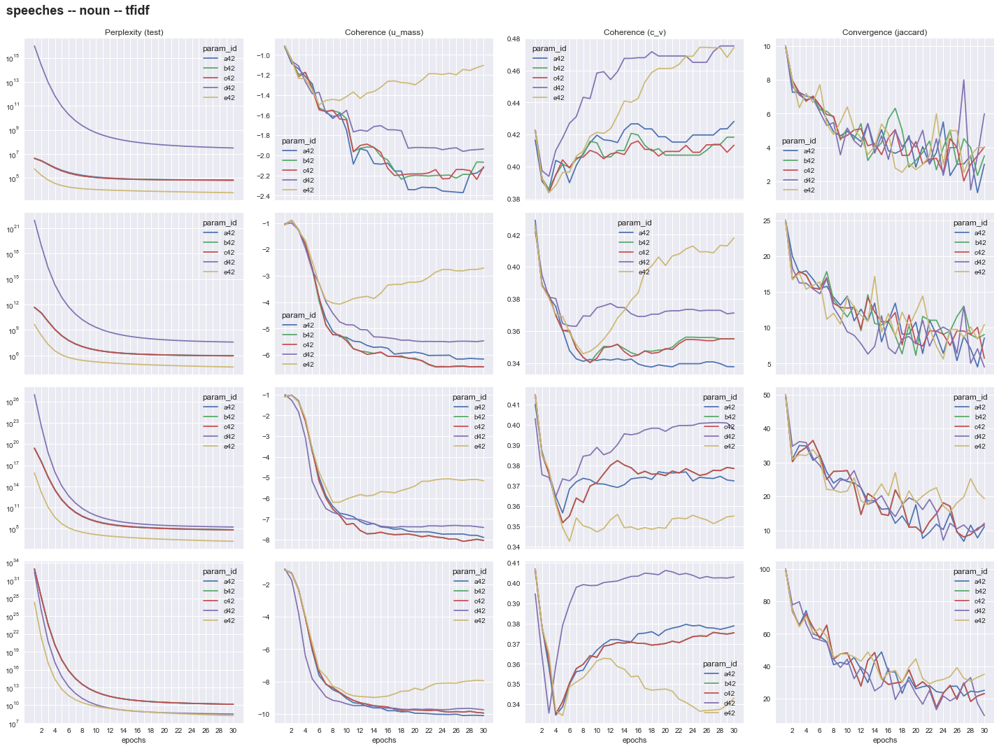

...

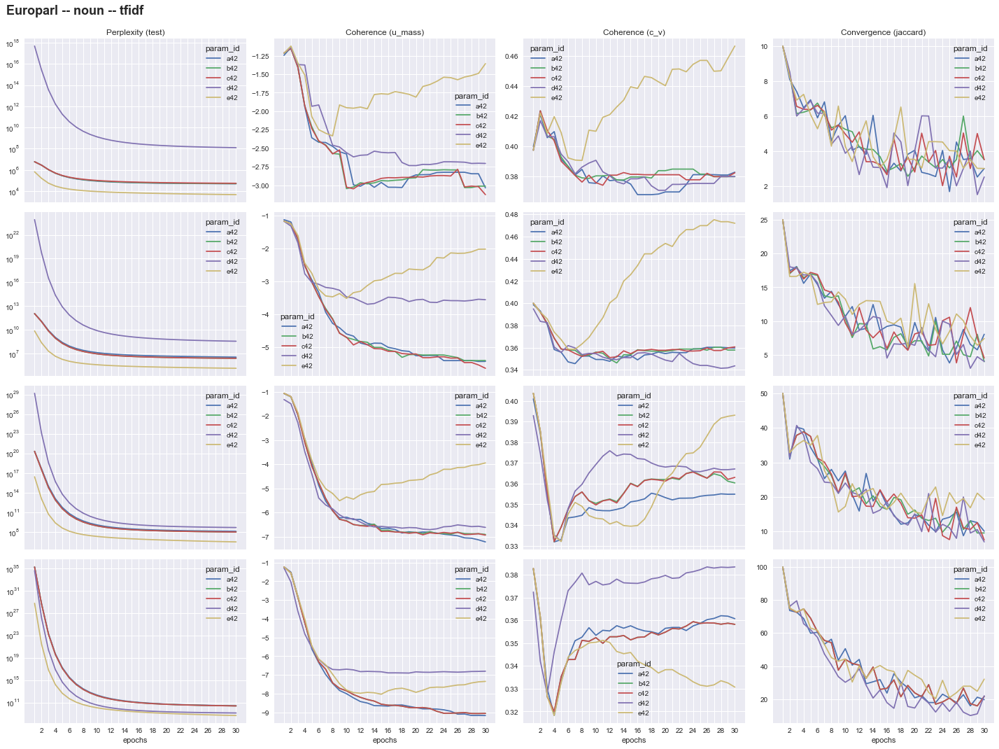

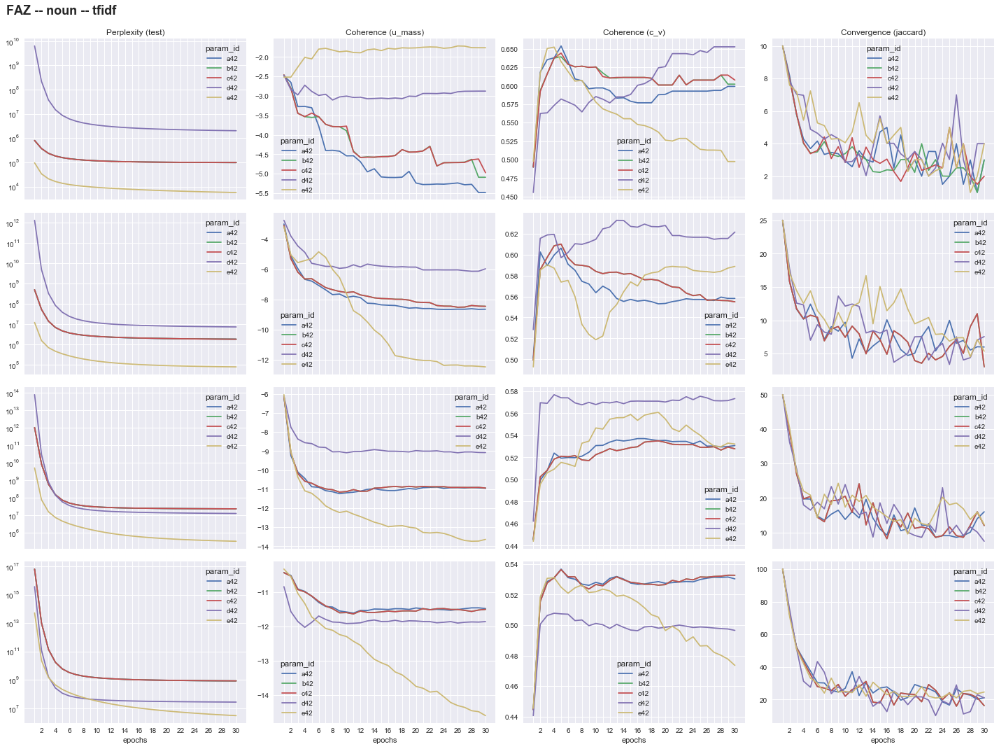

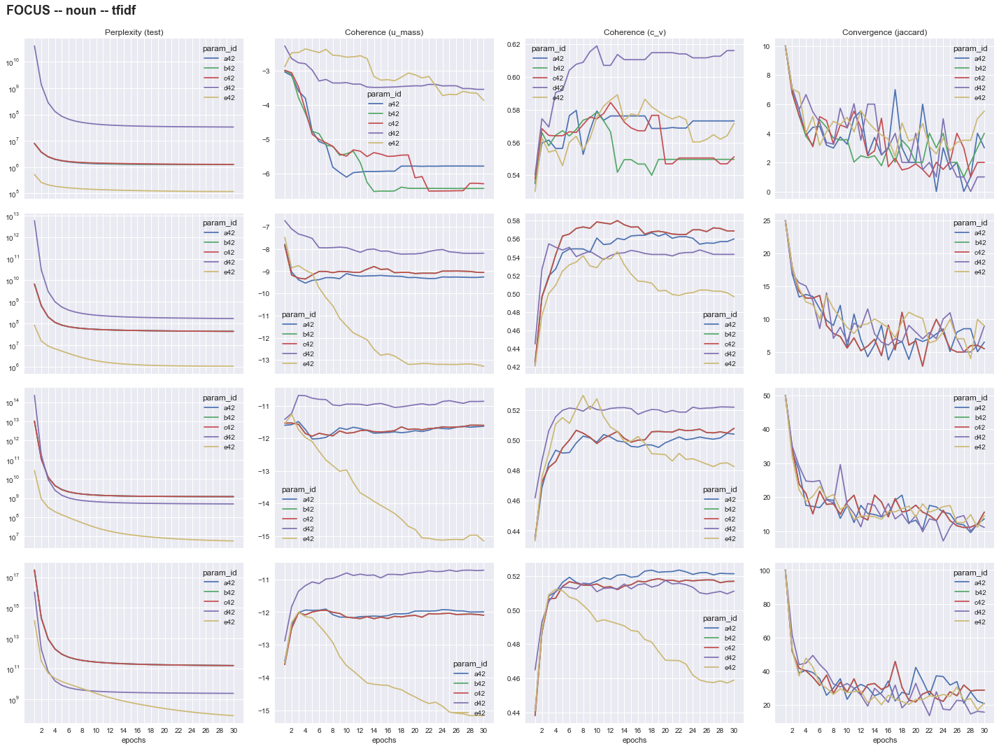

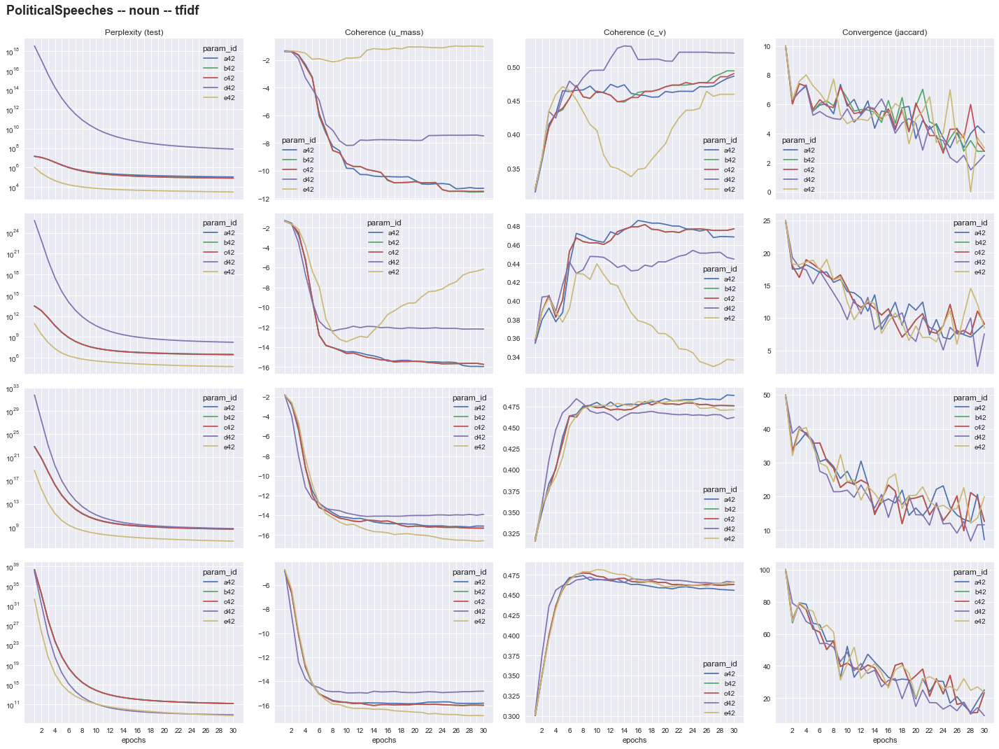

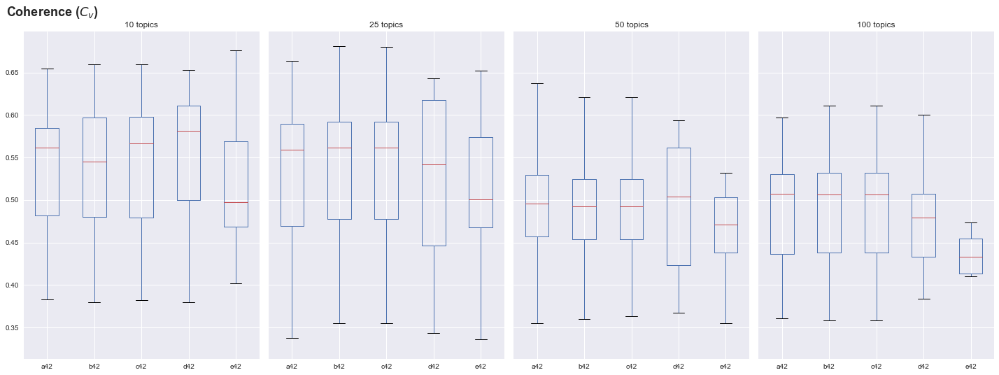

In [4]:
run(datasets=datasets, version='noun', corpus='tfidf', epochs=30)

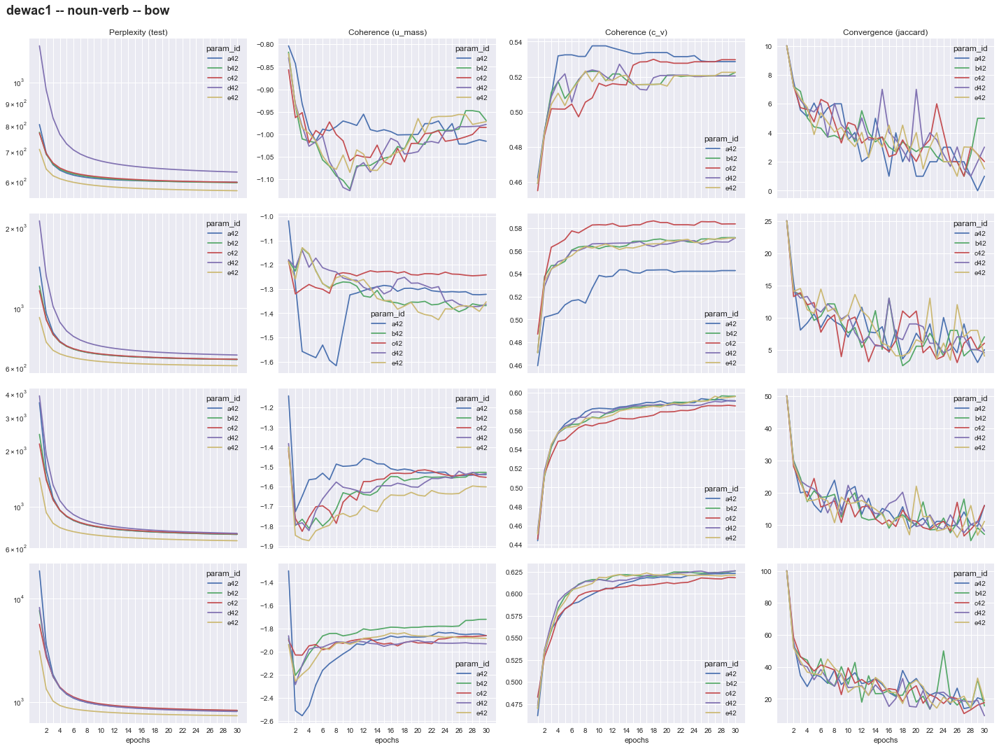

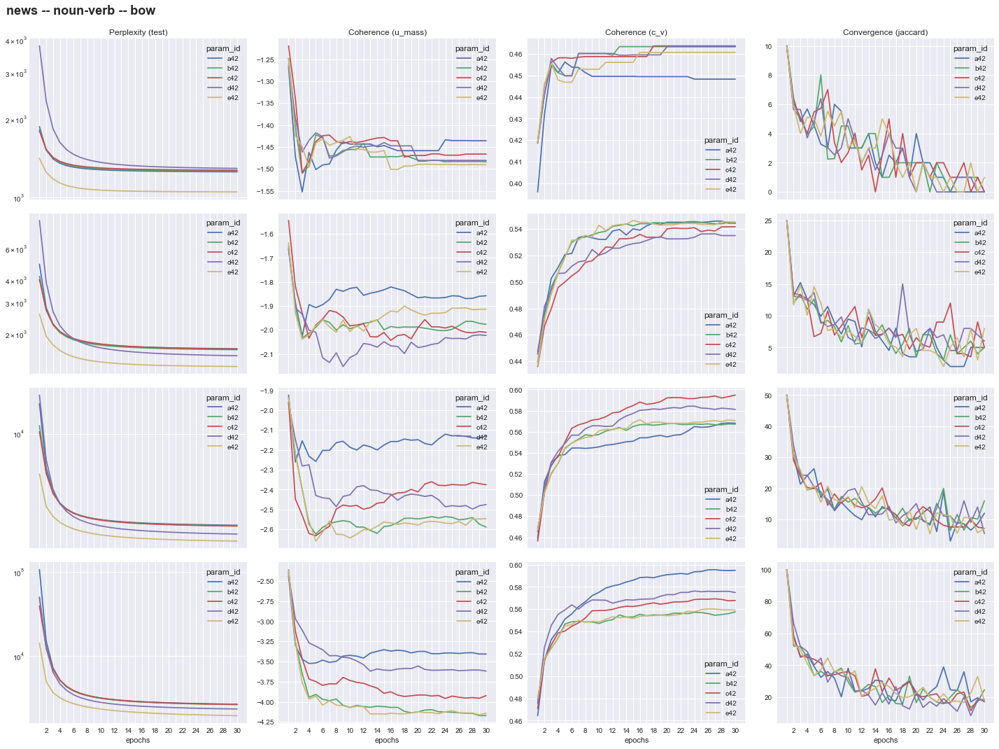

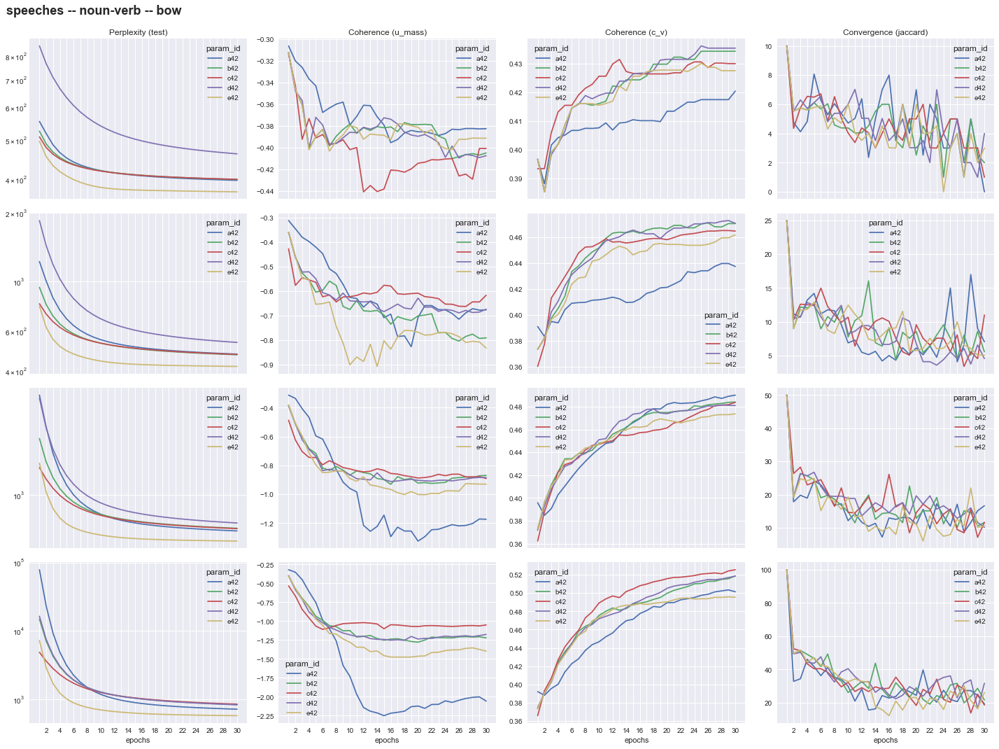

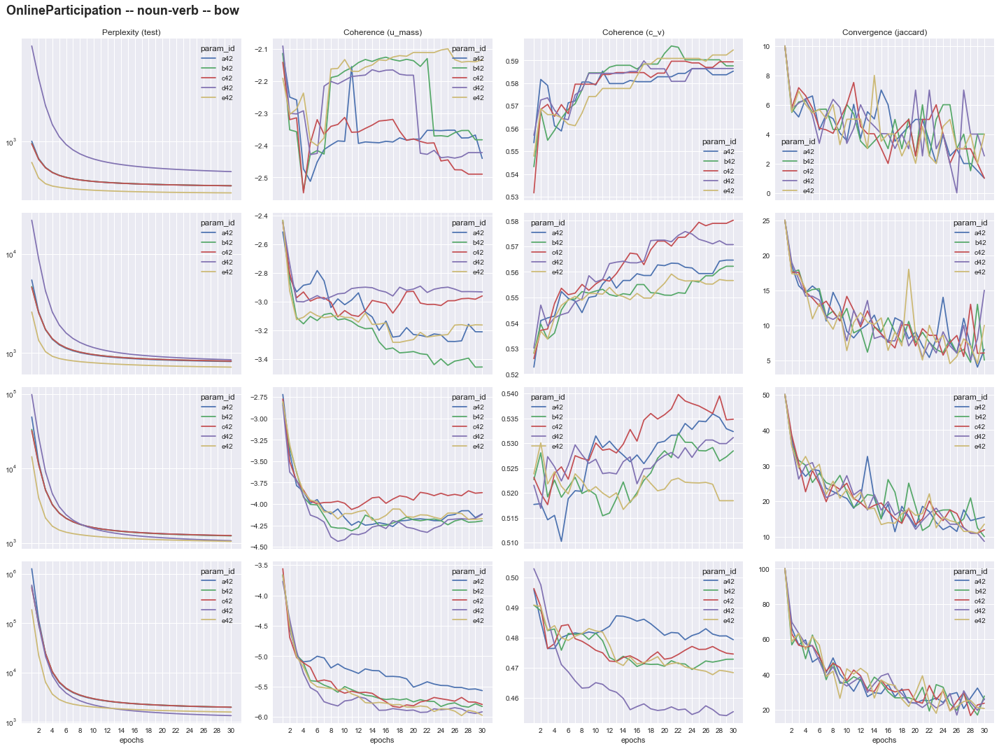

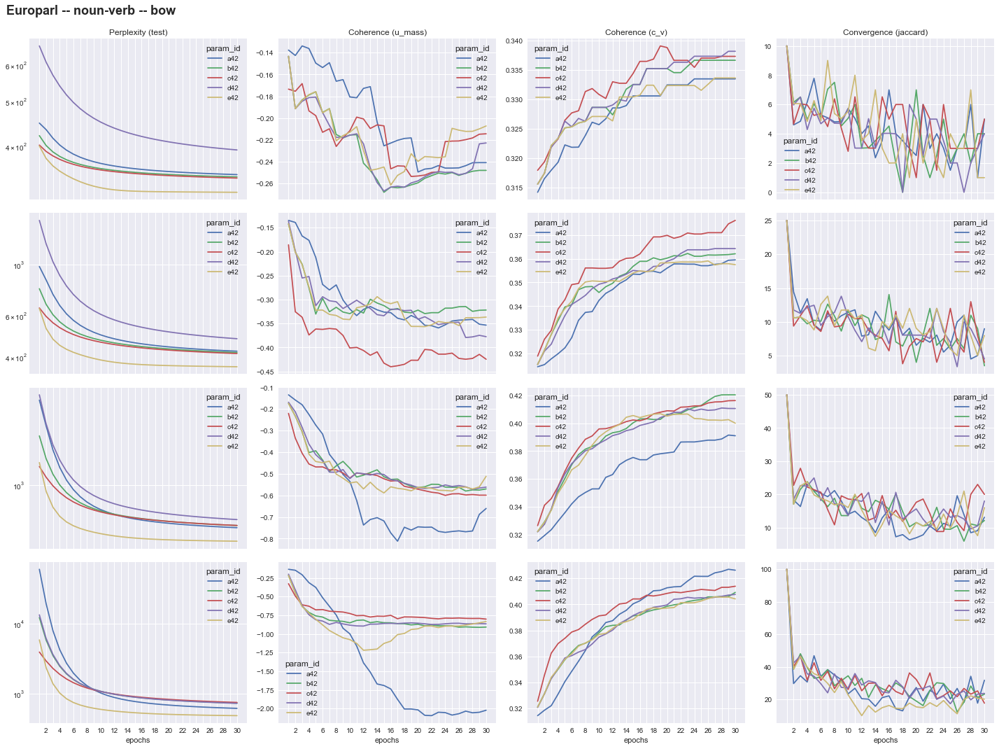

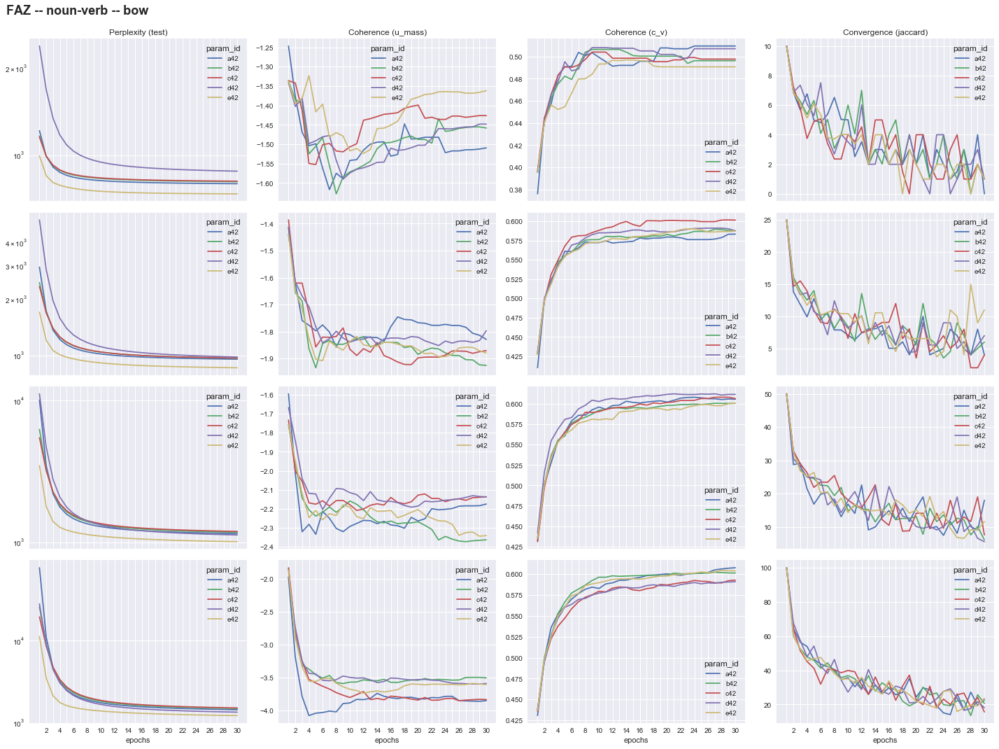

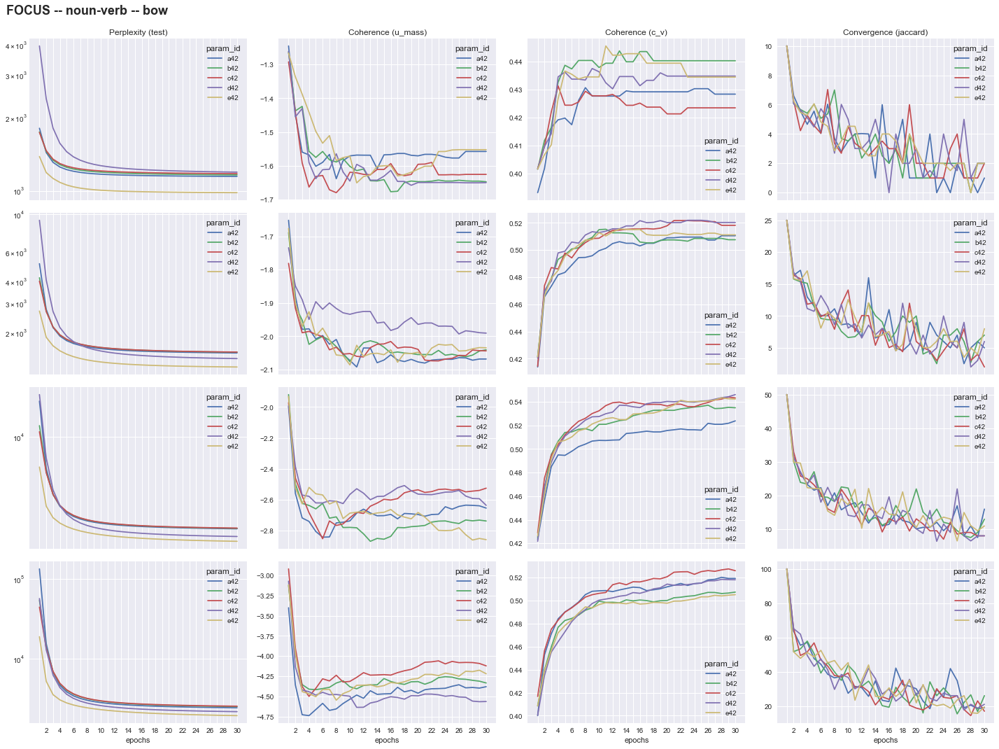

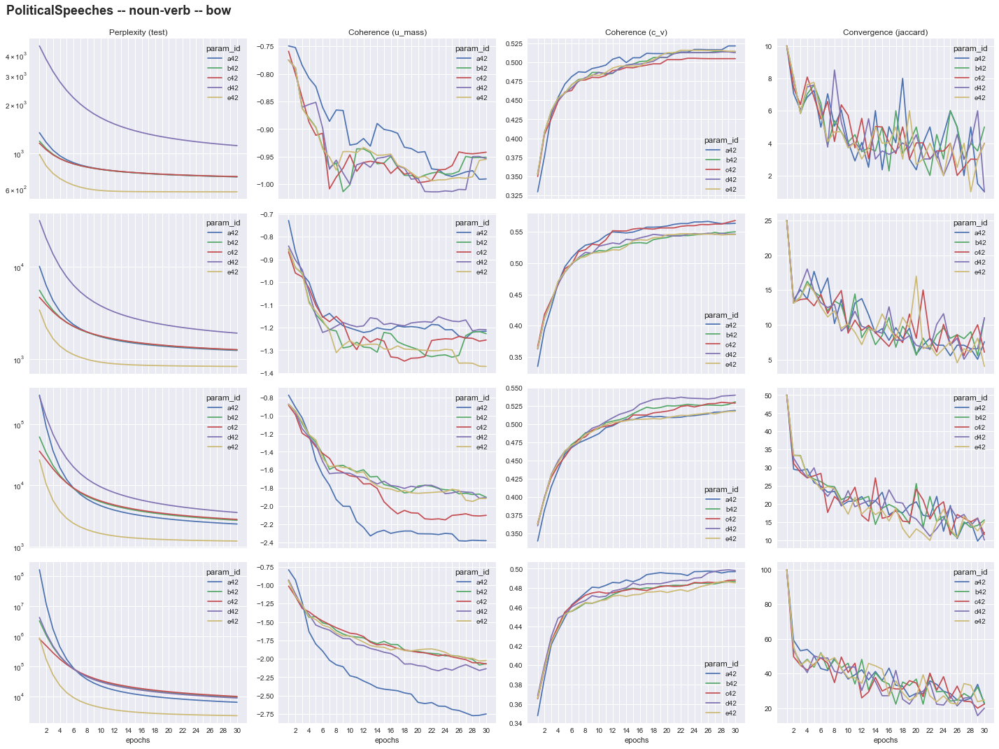

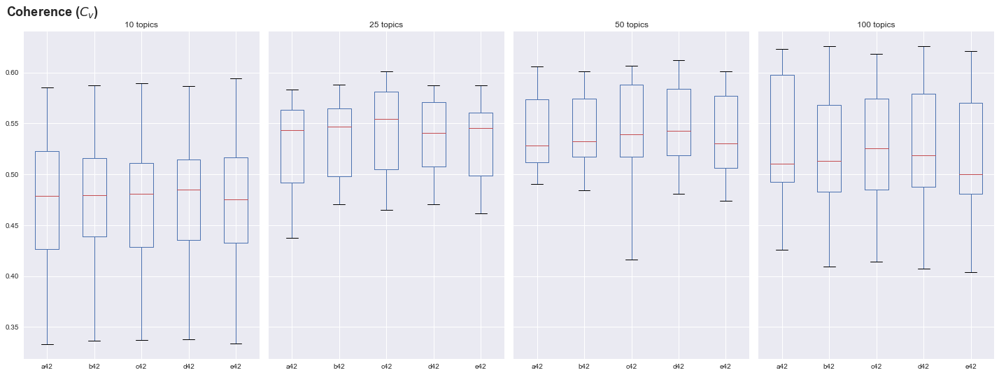

In [5]:
datasets = ['dewac1', 'news', 'speeches', DATASETS['O'], DATASETS['E'], DATASETS['FA'], DATASETS['FO'], DATASETS['P']]
run(datasets=datasets, version='noun-verb', corpus='bow', epochs=30)

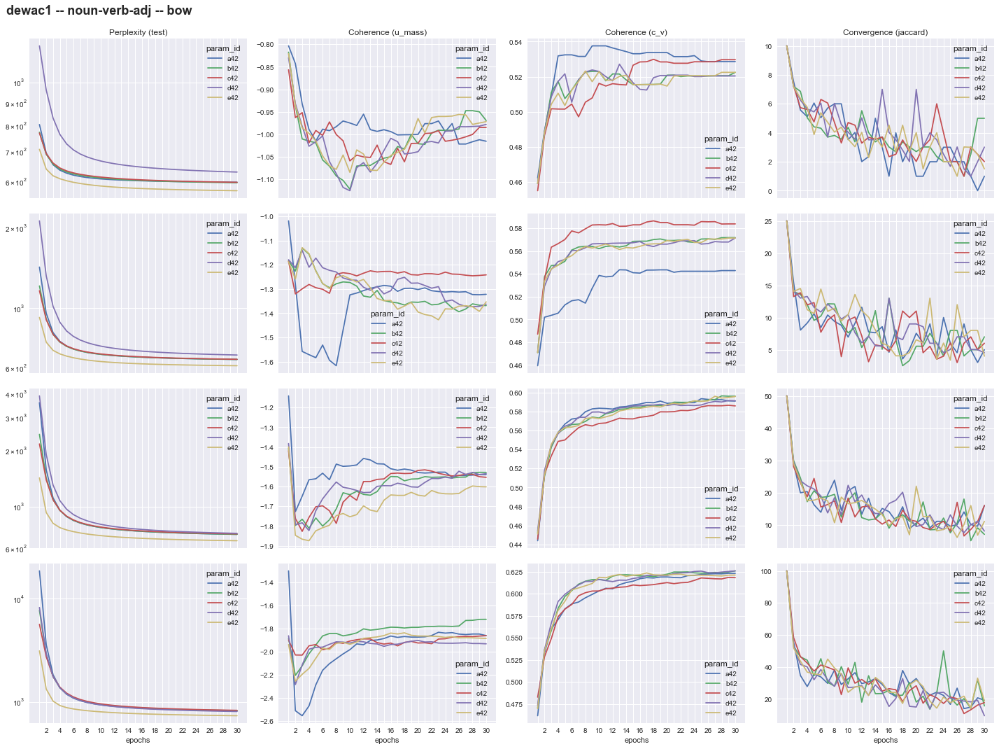

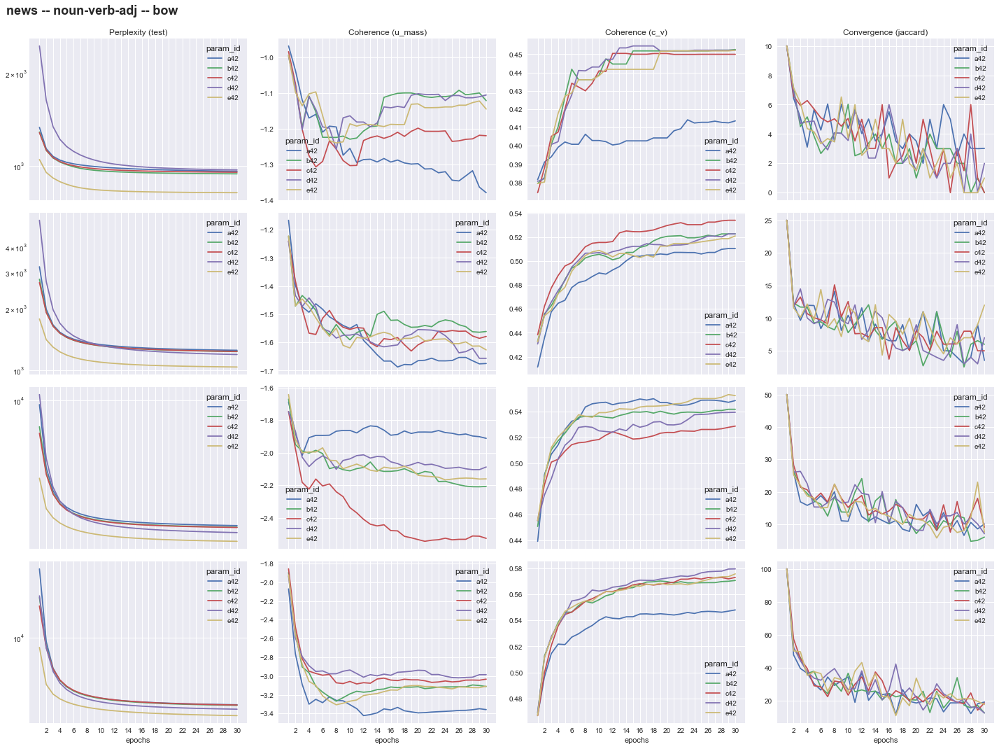

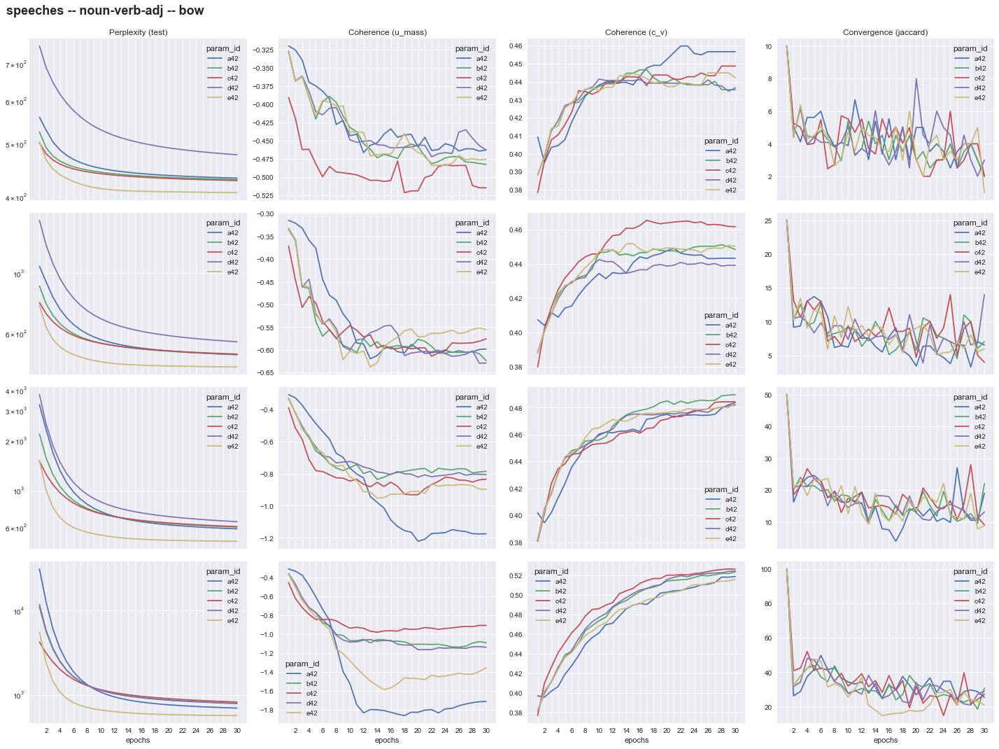

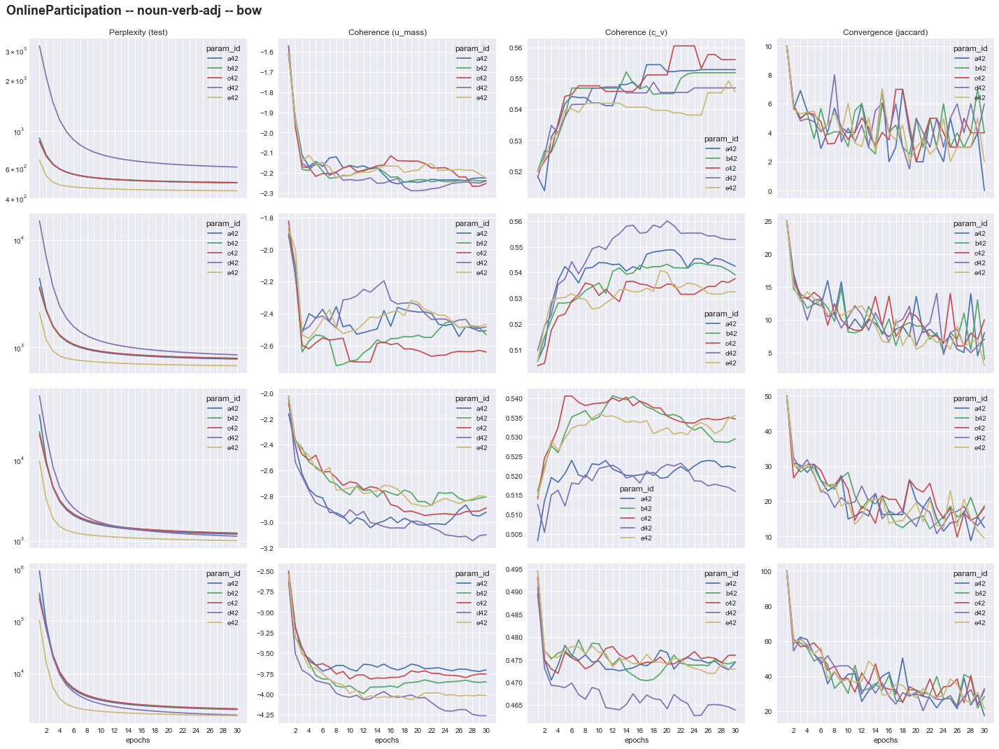

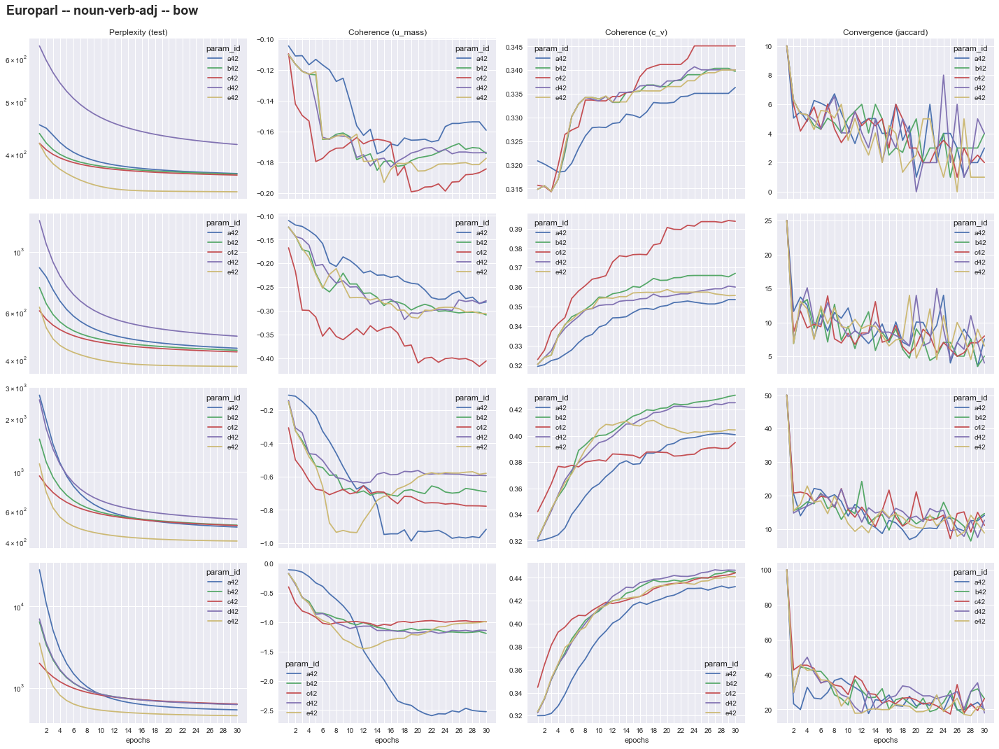

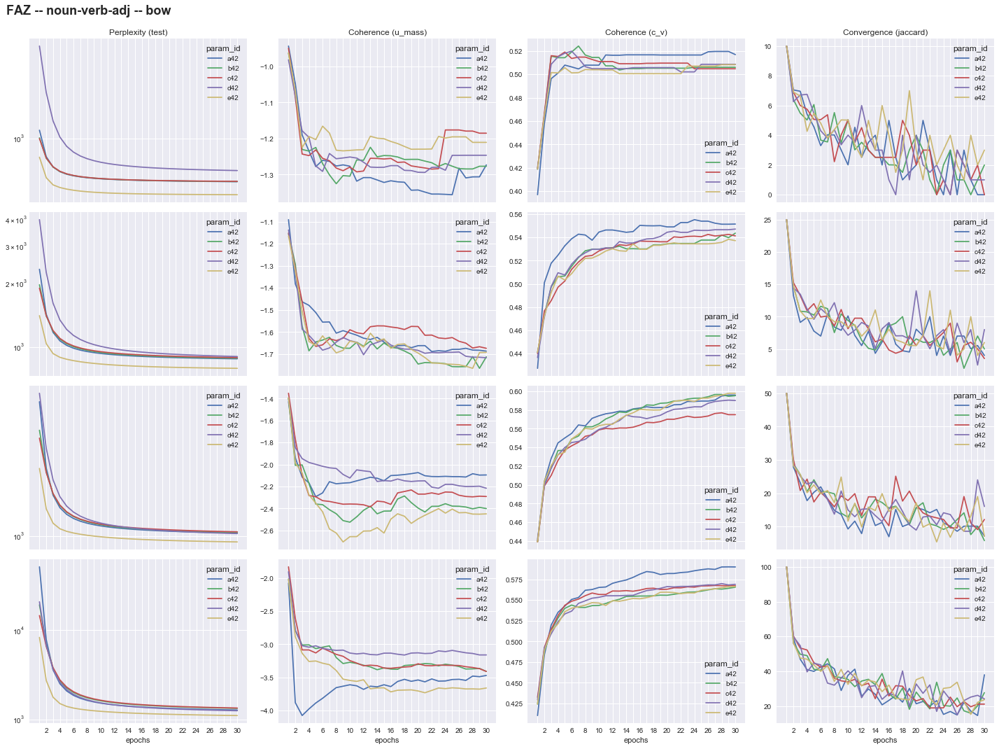

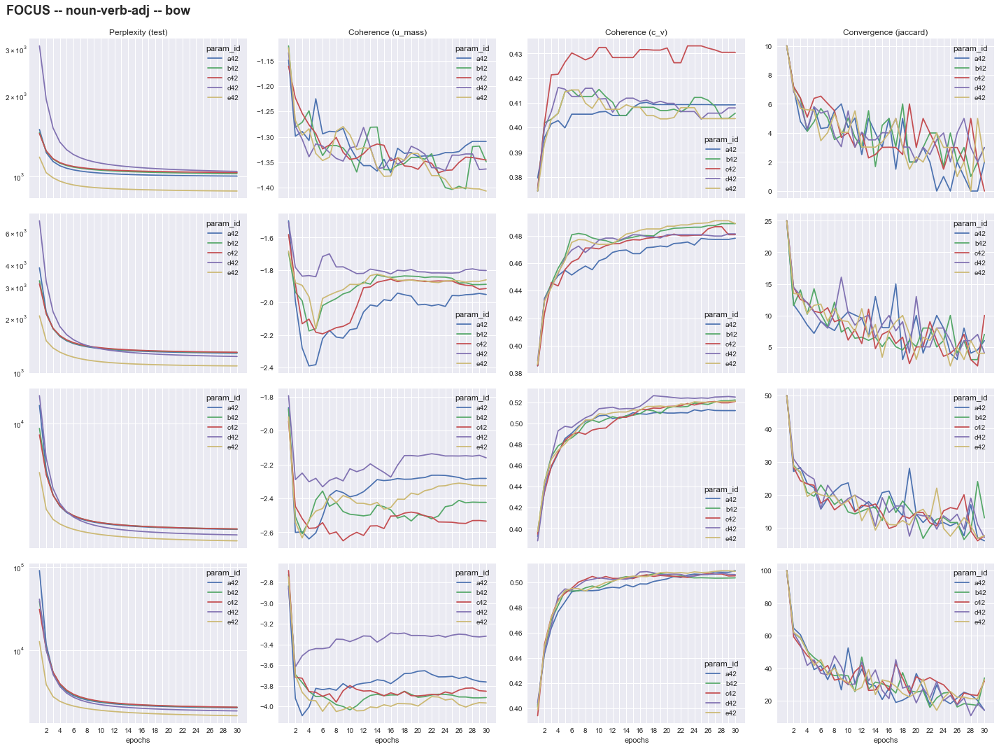

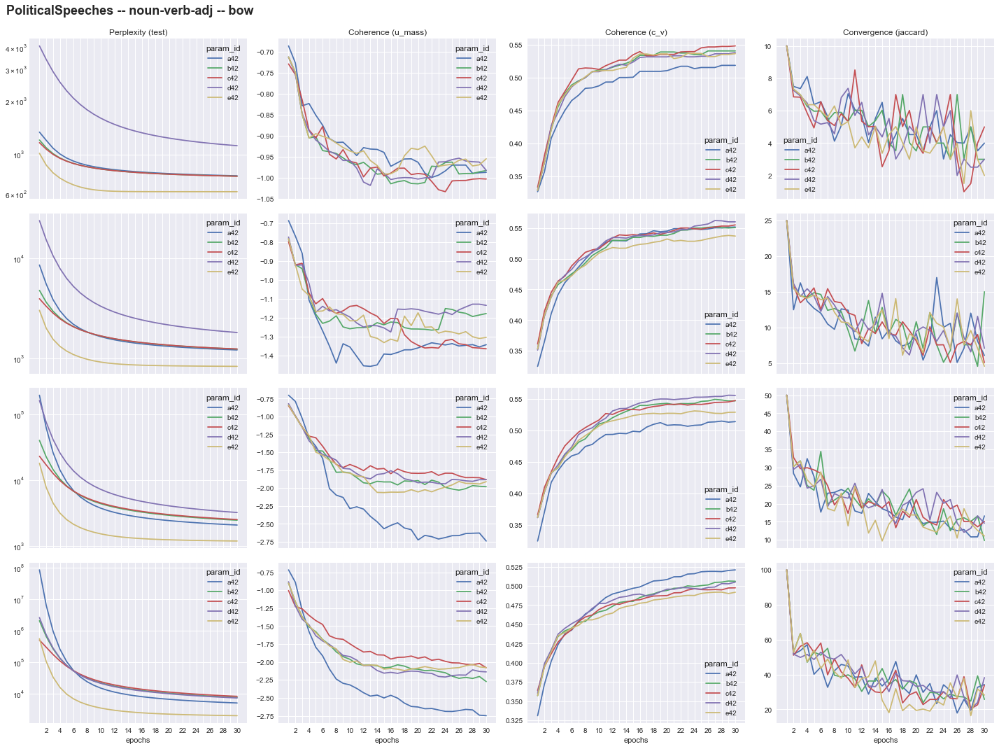

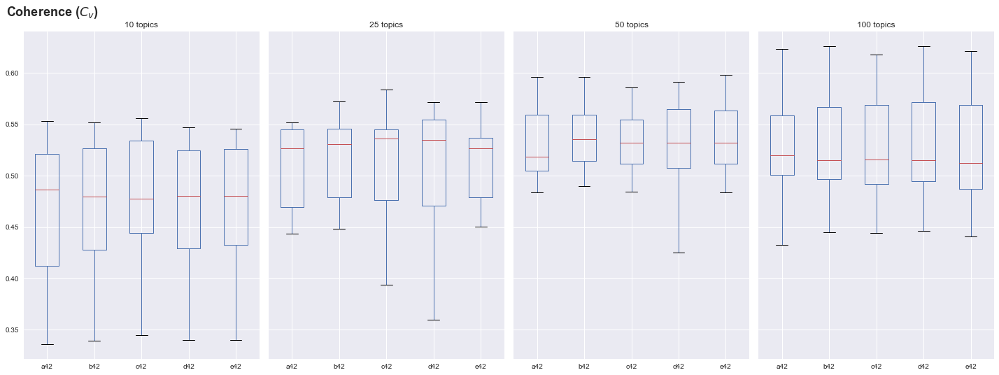

In [6]:
run(datasets=datasets, version='noun-verb-adj', corpus='bow', epochs=30)